In [1]:
%matplotlib inline

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import mlab
from scipy.signal import butter, freqz, lfilter, spectrogram

In [3]:
# Load in file to pandas dataframe
df = pd.read_table(
    "C:/Users/macka/Google Drive/Level-4-Project/data/raw/Dataset_97.dat",
    sep="\n",
    header=None)

In [4]:
# Switches out i for j to ensure python compatibility
def convert_to_complex(complex_string):
    return complex(complex_string[0].replace('i', 'j'))

In [12]:
# Grab RADAR settings from top of file
center_frequency = float(df.iloc[0])
sweep_time = float(df.iloc[1])/1000  # convert to seconds
number_of_time_samples = float(df.iloc[2])
bandwidth = float(df.iloc[3])
sampling_frequency = number_of_time_samples/sweep_time
record_length = 60
number_of_chirps = record_length/sweep_time

In [5]:
# Put data values into an array
data = df.iloc[4:]
data = data.apply(convert_to_complex, axis=1)
data = data.values

In [7]:
# Reshape into chirps over time
data_time = np.reshape(data, (int(number_of_chirps),int(number_of_time_samples)))
data_time = np.rot90(data_time, k=3)

In [8]:
# plt.imshow(abs(data_time),cmap='jet', aspect="auto")

In [9]:
win = np.ones((int(number_of_time_samples), data_time.shape[1]))

In [13]:
# Apply fast fourier transform
fft_applied = np.fft.fft((data_time * win), axis=0)

In [10]:
# plt.imshow(20*(np.log10(abs(fft_applied))),cmap='jet', aspect="auto")

In [14]:
# shift fft
fft_shifted = np.fft.fftshift(fft_applied, axes=(0,))

In [15]:
# plt.imshow(20*(np.log10(abs(fft_shifted))),cmap='jet', aspect="auto")

In [16]:
data_range = fft_shifted[int(number_of_time_samples/2):int(number_of_time_samples), :] # take top half

In [17]:
# plt.imshow(20*(np.log10(abs(data_range))),cmap='jet', aspect="auto")

In [18]:
def nearest_odd_number(x):
    if(np.floor(x) % 2 == 0):
        return int(np.floor(x) + 1)
    else:
        return int(np.floor(x))

In [19]:
# IIR Notch filter
x = data_range.shape[1]
ns = nearest_odd_number(x) - 1

In [20]:
data_range_MTI = np.zeros((data_range.shape[0], ns), dtype=np.complex128)

In [21]:
(b, a) = butter(4, 0.01, btype="high") # made a filter remove DC component and very low frequency components

In [22]:
(f1, h) = freqz(b, a, ns)

In [23]:
for i in range(data_range.shape[0]):
    data_range_MTI[i, :ns] = lfilter(b, a, data_range[i, :ns], axis=0)

In [24]:
# plt.imshow(20*(np.log10(abs(data_range_MTI))),cmap='jet', aspect="auto")

In [25]:
freq = np.arange(0, ns-1)
freq = freq * sampling_frequency/(2*ns)

In [26]:
range_axis = (freq * 3e8*sweep_time)/(2*bandwidth)

In [27]:
data_range_MTI = data_range_MTI[1:, :]
data_range = data_range[1:, :]

In [28]:
# plt.xlabel("No. of Sweeps")
# plt.ylabel("Range Bins")
# plt.imshow(20 * np.log10(abs(data_range_MTI)),cmap='jet', aspect="auto")

In [35]:
bin_indl = 5
bin_indu = 25
MD = {}
MD["PRF"] = 1/sweep_time
MD["TimeWindowLength"] = 200
MD["OverlapFactor"] = 0.95
MD["OverlapLength"] = np.round(MD["TimeWindowLength"] * MD["OverlapFactor"])
MD["Pad_Factor"] = 4
MD["FFTPoints"] = MD["Pad_Factor"]*MD["TimeWindowLength"]
MD["DopplerBin"] = MD["PRF"]/MD["FFTPoints"]
MD["DopplerAxis"] = np.arange(-MD["PRF"]/2, MD["PRF"]/2-MD["DopplerBin"]+1, MD["DopplerBin"])               
MD["WholeDuration"] = data_range_MTI.shape[1]/MD["PRF"]

MD["NumSegments"] = np.floor(
    (data_range_MTI.shape[1]-MD["TimeWindowLength"])/
    (np.floor(MD["TimeWindowLength"]*(1-MD["OverlapFactor"])))
)

In [36]:
data_spec_MTI2=0
for rbin in range(bin_indl-1, bin_indu):    
    s, f, t = mlab.specgram(data_range_MTI[rbin, :],
                            Fs=1,
                            window=np.hamming(MD["TimeWindowLength"]),
                            noverlap=MD["OverlapLength"],
                            NFFT=MD["TimeWindowLength"], 
                            mode='complex',
                            pad_to=MD["FFTPoints"] )
    
    data_MTI_temp = np.fft.fftshift(s, 1)
    data_spec_MTI2=data_spec_MTI2+abs(data_MTI_temp);                                


In [37]:
MD["TimeAxis"] = np.linspace(0,MD["WholeDuration"], data_spec_MTI2.shape[1])

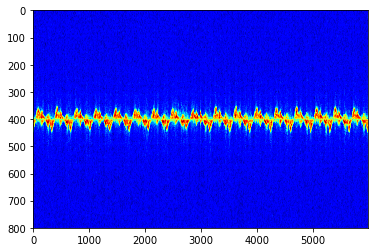

In [38]:
plt.imshow(20 * np.log10(abs(data_spec_MTI2)),cmap='jet', aspect="auto")

Text(0, 0.5, 'Doppler [Hz]')

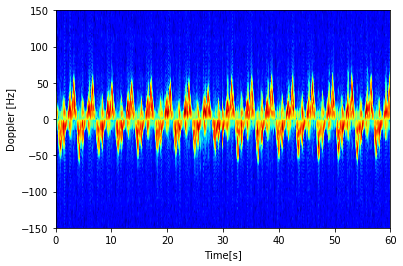

In [39]:
plt.pcolormesh(MD["TimeAxis"], MD["DopplerAxis"],20 * np.log10(np.abs(data_spec_MTI2)),cmap='jet')
plt.ylim([-150, 150])
plt.xlabel("Time[s]")
plt.ylabel("Doppler [Hz]")

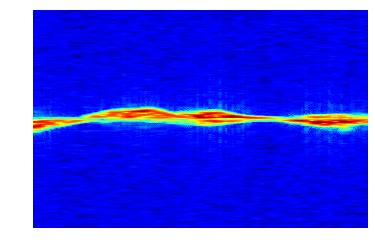

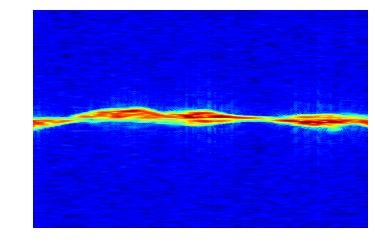

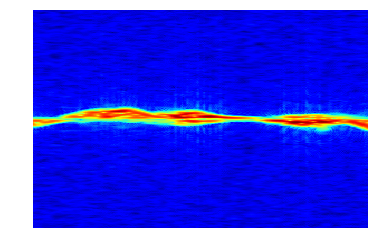

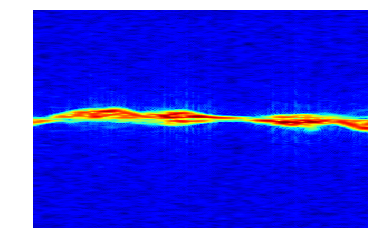

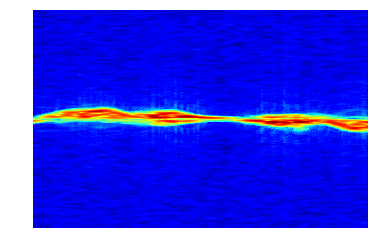

...

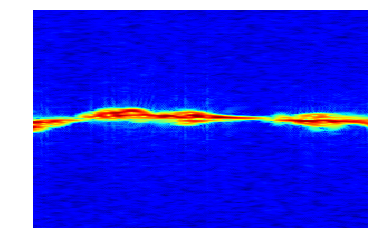

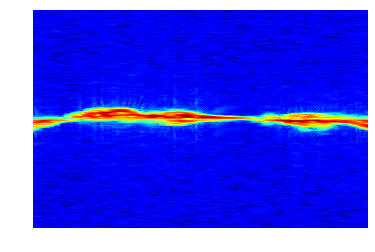

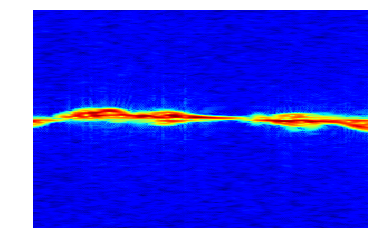

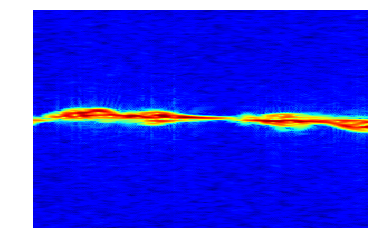

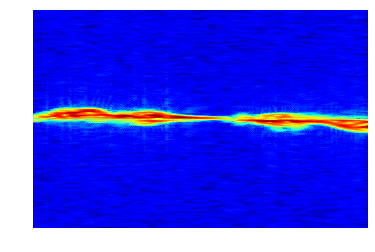

In [40]:
    iterations = 5700  # 57 seconds
    window_size = 300  # 3 seconds
    step_size = 10  # 0.1 seconds
    for i in range(0, iterations, step_size):
        data_spec_small = data_spec_MTI2[:, i:(i + window_size)]
        plt.imshow(20 * np.log10(abs(data_spec_small)), cmap='jet', aspect="auto")
        plt.axis('off')
        plt.show()